# The Stable Diffusion Guide 

## Prompt engineering

In [3]:
model_id = "runwayml/stable-diffusion-v1-5"    

## Speed Optimization

In [4]:
from diffusers import StableDiffusionPipeline 
import torch

pipe = StableDiffusionPipeline.from_pretrained(model_id)

/usr/local/lib/python3.8/dist-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Fetching 15 files: 100%|██████████| 15/15 [00:00<00:00, 90524.55it/s]


In [5]:
prompt = "portrait photo of a old warrior chief"  

In [6]:
pipe = pipe.to("cuda")  

In [7]:
generator = torch.Generator("cuda").manual_seed(0)  

100%|██████████| 50/50 [00:06<00:00,  8.14it/s]


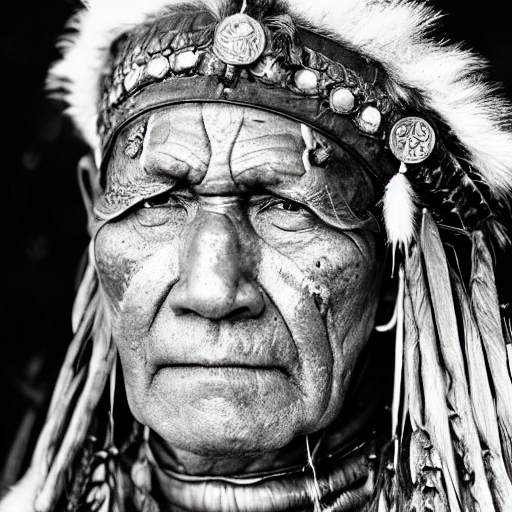

In [8]:
image = pipe(prompt, generator=generator).images[0]                                                                                                                                                                                           
image     

In [ ]:
import torch                                                                                                                                                                                                                                  

pipe = StableDiffusionPipeline.from_pretrained(model_id,revision="fp16", torch_dtype=torch.float16)                                                                                                                                                           
pipe = pipe.to("cuda") 

100%|██████████| 50/50 [00:02<00:00, 18.04it/s]


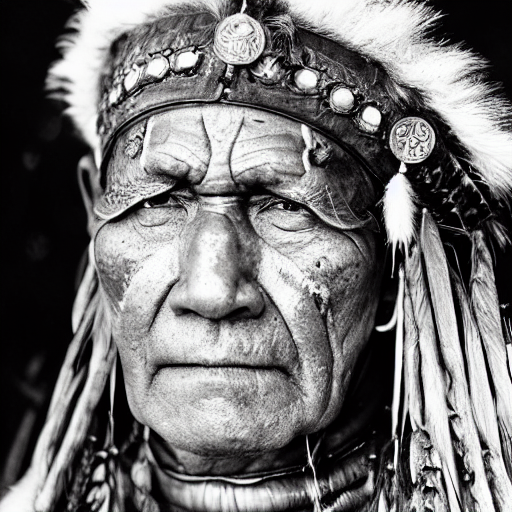

In [33]:
generator = torch.Generator("cuda").manual_seed(0)                                                                                                                                                                                            

with torch.autocast("cuda"):
    image = pipe(prompt, generator=generator).images[0]                                                                                                                                                                                           
image      

In [35]:
pipe.scheduler.compatibles    

[diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler]

In [37]:
from diffusers import DPMSolverMultistepScheduler                                                                                                                                                                                             
                                                                                                                                                                                                                                              
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)  

100%|██████████| 20/20 [00:01<00:00, 17.87it/s]


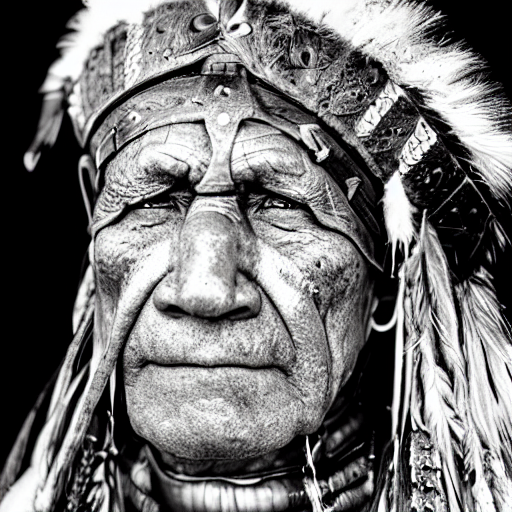

In [41]:
generator = torch.Generator("cuda").manual_seed(0)                                                                                                                                                                                            

with torch.autocast("cuda"):
    image = pipe(prompt, generator=generator, num_inference_steps=20).images[0]                                                                                                                                                                   
image             

## Memory Optimization

In [42]:
def get_inputs(batch_size=1):                                                                                                                                                                                                                 
  generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]                                                                                                                                                             
  prompts = batch_size * [prompt]                                                                                                                                                                                                             
  num_inference_steps = 20                                                                                                                                                                                                                    

  return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}     

In [43]:
from PIL import Image                                                                                                                                                                                                                         

def image_grid(imgs, rows=2, cols=2):                                                                                                                                                                                                         
    w, h = imgs[0].size                                                                                                                                                                                                                       
    grid = Image.new('RGB', size=(cols*w, rows*h))                                                                                                                                                                                            
                                                                                                                                                                                                                                              
    for i, img in enumerate(imgs):                                                                                                                                                                                                            
        grid.paste(img, box=(i%cols*w, i//cols*h))                                                                                                                                                                                            
    return grid                                   

100%|██████████| 20/20 [00:03<00:00,  6.35it/s]


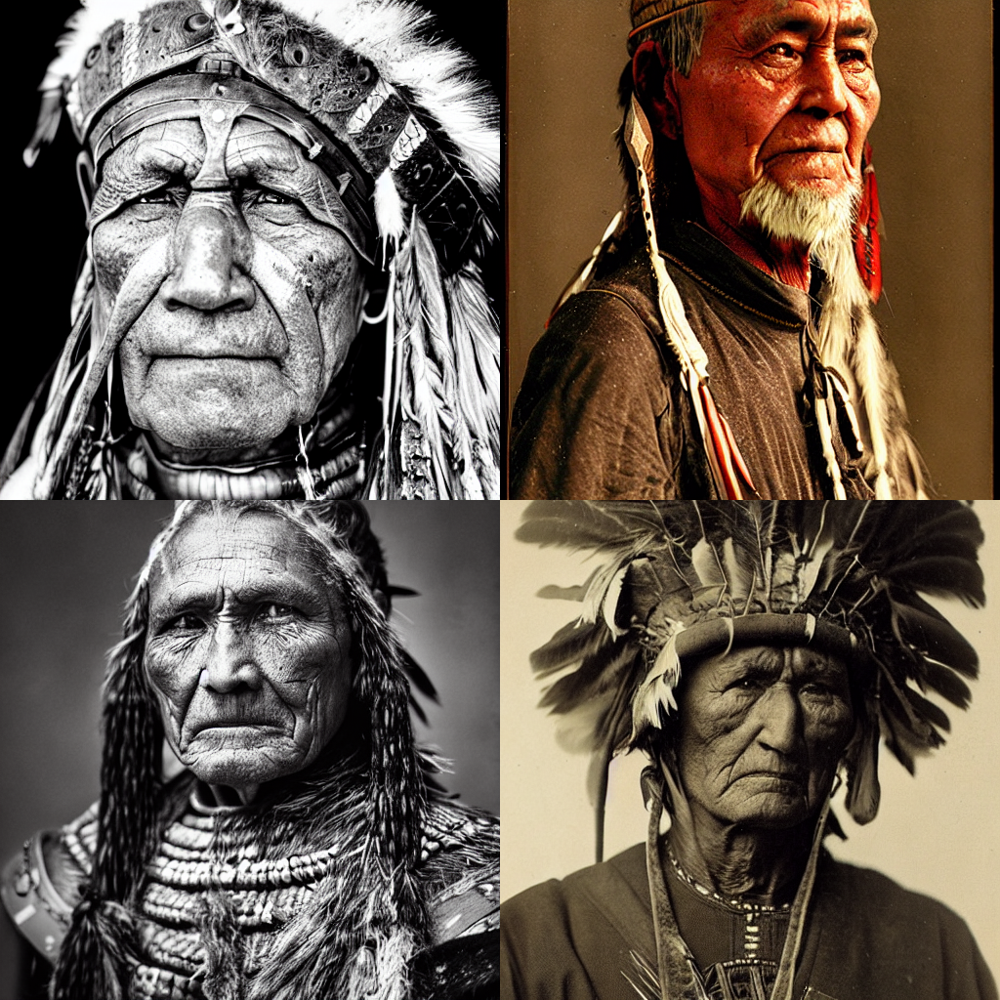

In [45]:
with torch.autocast("cuda"):
    images = pipe(**get_inputs(batch_size=4)).images                                                                                                                                                                                              
image_grid(images)    

In [46]:
pipe.enable_attention_slicing() 

100%|██████████| 20/20 [00:06<00:00,  3.11it/s]


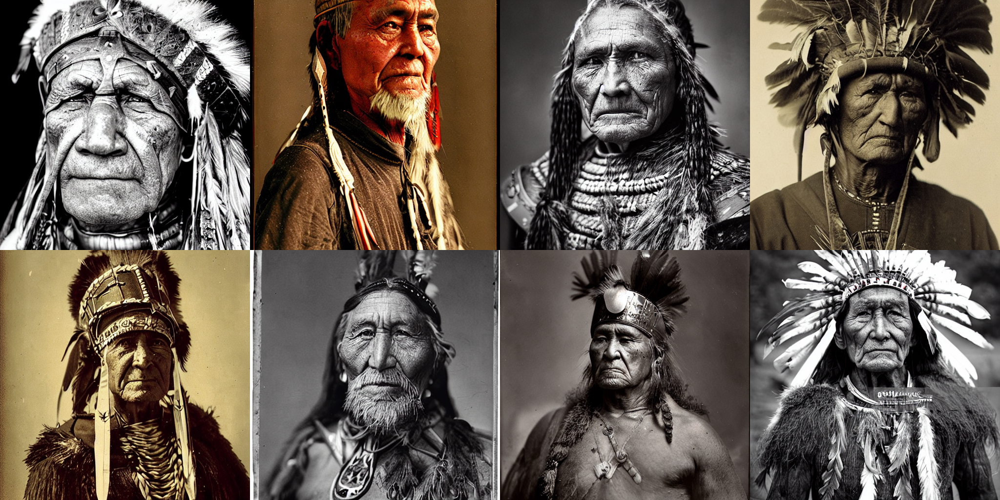

In [49]:
with torch.autocast('cuda'):
    images = pipe(**get_inputs(batch_size=8)).images                                                                                                                                                                                              
image_grid(images, rows=2, cols=4) 

## Quality Improvements

In [50]:
from diffusers import AutoencoderKL                                                                                                                                                                                                           

vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")  

In [52]:
pipe.vae = vae          

100%|██████████| 20/20 [00:06<00:00,  3.12it/s]


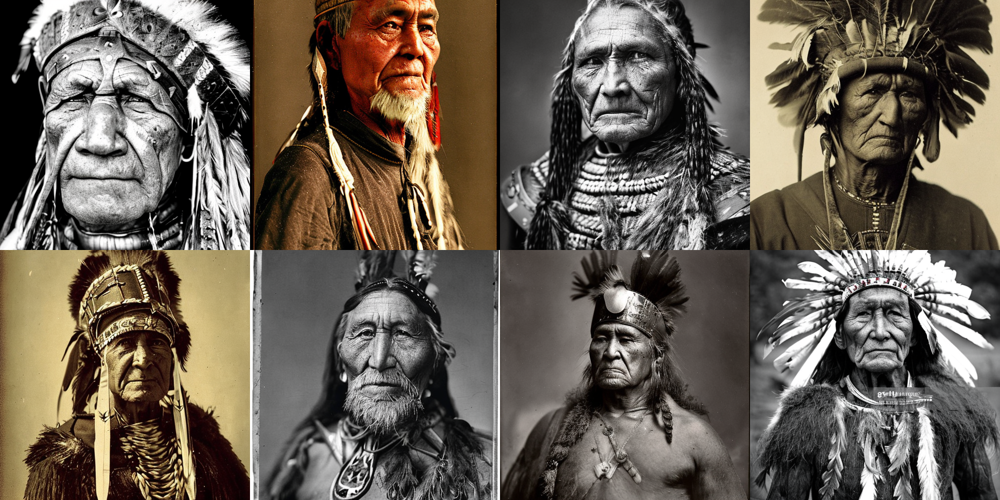

In [53]:
with torch.autocast('cuda'):
    images = pipe(**get_inputs(batch_size=8)).images                                                                                                                                                                                              
image_grid(images, rows=2, cols=4)    

In [54]:
prompt += ", tribal panther make up, blue on red, side profile, looking away, serious eyes"                                                                                                                                                   

In [55]:
prompt += " 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta"                                                                                                                                         
prompt                                                                                                                                                                                                                                        

'portrait photo of a old warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta'

100%|██████████| 20/20 [00:06<00:00,  3.12it/s]


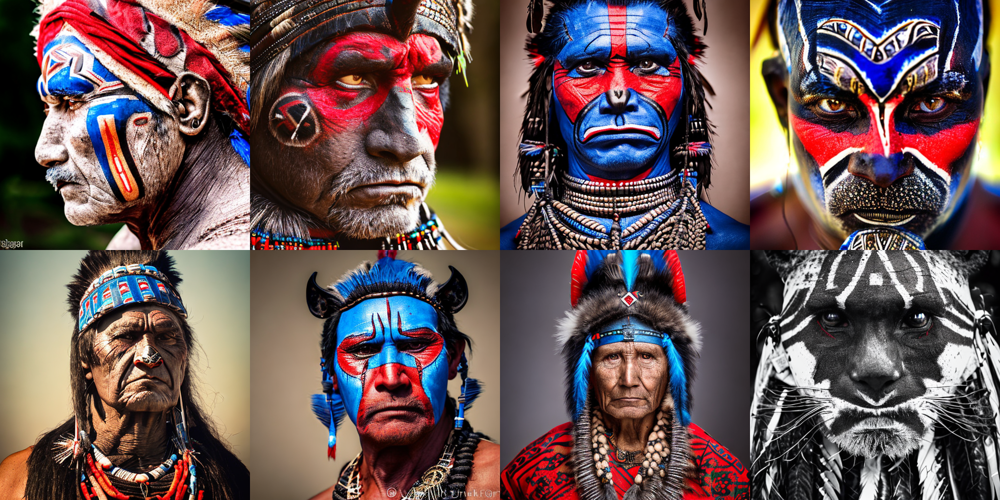

In [57]:
with torch.autocast('cuda'):
    images = pipe(**get_inputs(batch_size=8)).images                                                                                                                                                                                              
image_grid(images, rows=2, cols=4)                                                                                                                                                                                                            

100%|██████████| 25/25 [00:04<00:00,  5.86it/s]


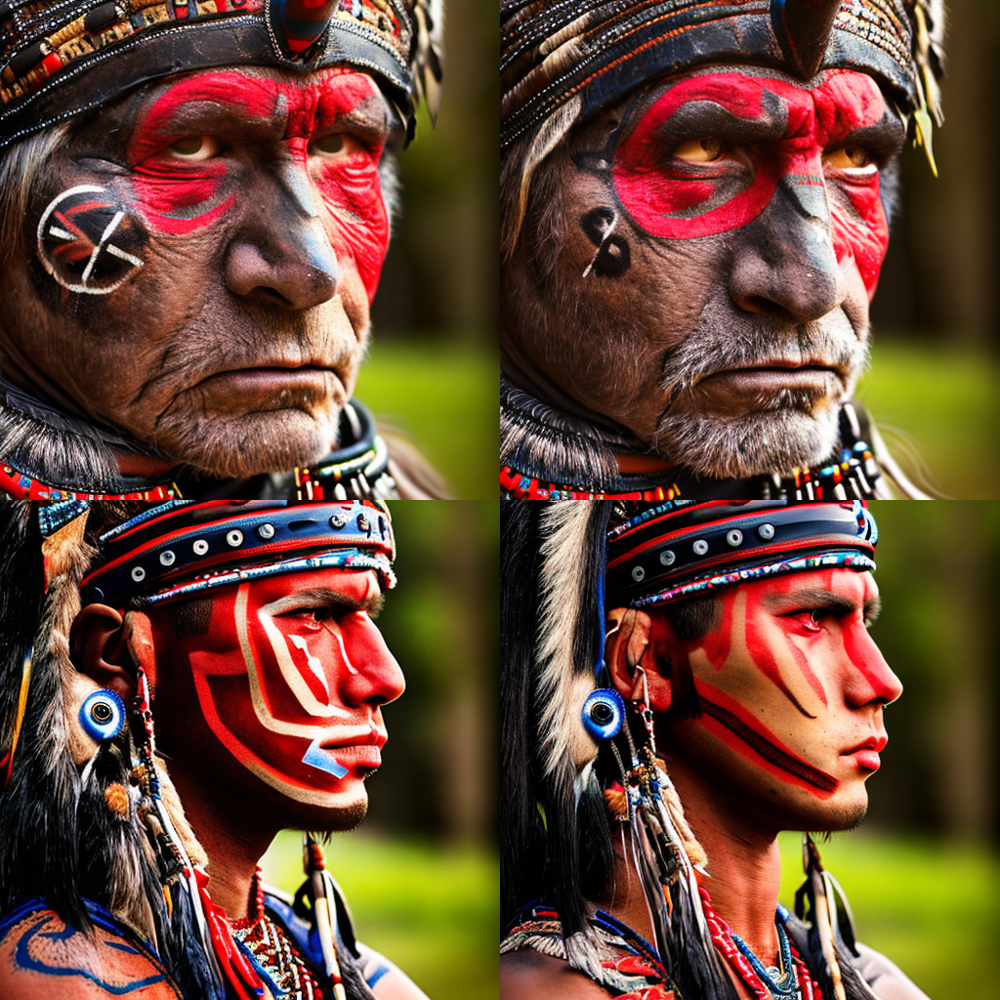

In [59]:
prompts = [                                                                                                                                                                                                                                   
    "portrait photo of the oldest warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                   
    "portrait photo of a old warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                        
    "portrait photo of a warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                            
    "portrait photo of a young warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                      
]                                                                                                                                                                                                                                             

generator = [torch.Generator("cuda").manual_seed(1) for _ in range(len(prompts))]  # 1 because we want the 2nd image                                                                                                                          

with torch.autocast('cuda'):
    images = pipe(prompt=prompts, generator=generator, num_inference_steps=25).images                                                                                                                                                             
image_grid(images)                                                                                                                                                                                                                            

In [10]:
image.save('./output_a.png')

In [51]:
# Save models


#　Now all model components of the pipeline are stored in half-precision dtype. We can now save the pipeline under a "fp16" variant as follows:
pipe.save_pretrained(save_directory="./checkpoints/runwayml/stable-diffusion-v1-5_fp16") #,variant="fp16" runwayml/stable-diffusion-v1-5